In [14]:
import sys
from os.path import join
sys.path.append('/work/mflora/ROAD_SURFACE')
sys.path.append('/home/monte.flora/python_packages/scikit-explain')

from skexplain.plot.base_plotting import PlotStructure
from matplotlib.lines import Line2D
from skexplain import ExplainToolkit
from skexplain.common.importance_utils import to_skexplain_importance

from ml_workflow.ml_methods import norm_aupdc, brier_skill_score
from ml_workflow import CalibratedPipelineHyperOptCV
from ml_workflow.ml_methods import get_bootstrap_score
from calibration_classifier import CalibratedClassifier
from sklearn.compose import TransformedTargetRegressor
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression


from sklearn.metrics import r2_score, mean_squared_error
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt
from os.path import join
import pickle
from joblib import load
import pandas as pd
import numpy as np
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.linear_model import RidgeCV


from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
import hyperopt.hp as hp
import seaborn as sns
import itertools
sns.set_theme(palette=sns.color_palette("Set2"), rc={"xtick.bottom" : True, "ytick.left" : True})

from scipy.stats import spearmanr, kendalltau
from probsr_config import TARGET_COLUMN, PREDICTOR_COLUMNS

In [15]:
time='first_hour'
targets = ['tornado', 'severe_hail', 'severe_wind']
opt = 'L1_based_feature_selection_with_manual'
N_BOOT = 100
base_plt = PlotStructure(BASE_FONT_SIZE = 16)

In [16]:
mapper = {'multipass__forward' : 'FMP', 
           'singlepass__forward' : 'FSP', 
           'multipass__backward' : 'BMP', 
           'singlepass__backward' : 'BSP', 
           'ale_variance' : 'ALE', 
           'shap_sum' : 'SHAP', 
          'coefs' : 'COEF.', 
          'sage' : 'SAGE', 
         'gini' : 'GINI', 
         'lime' : 'LIME',
          'tree_interpreter' : 'TI'
         
         }

pretty = {'multipass__forward' : 'Forward\nMultipass', 
           'singlepass__forward' : 'Forward\nSinglepass', 
           'multipass__backward' : 'Backward\nMultipass', 
           'singlepass__backward' : 'Backward\nSinglepass', 
           'ale_variance' : 'ALE Variance', 
           'shap_sum' : 'SHAP', 
          'coefs' : 'LR Coefficients', 
          'sage' : 'SAGE', 
         'gini' : 'Gini Impurity', 
         'lime' : 'LIME', 
        'tree_interpreter' : 'Tree Interpt.'
         
         }


lr_methods = ['multipass__backward',  'singlepass__backward', 'multipass__forward', 'singlepass__forward', 
          'ale_variance', 'shap_sum', 'sage', 'lime', 'coefs']

rf_methods = ['multipass__backward',  'singlepass__backward', 'multipass__forward', 'singlepass__forward', 
          'ale_variance', 'shap_sum', 'sage', 'lime', 'tree_interpreter', 'gini']

colors_dict = {m : c for m,c in zip(rf_methods, sns.color_palette("Set2")+['k'])}

colors_dict['coefs'] = 'red'
colors_dict['gini'] = colors_dict['coefs']

In [17]:
colors_dict

{'multipass__backward': (0.4, 0.7607843137254902, 0.6470588235294118),
 'singlepass__backward': (0.9882352941176471,
  0.5529411764705883,
  0.3843137254901961),
 'multipass__forward': (0.5529411764705883,
  0.6274509803921569,
  0.796078431372549),
 'singlepass__forward': (0.9058823529411765,
  0.5411764705882353,
  0.7647058823529411),
 'ale_variance': (0.6509803921568628, 0.8470588235294118, 0.32941176470588235),
 'shap_sum': (1.0, 0.8509803921568627, 0.1843137254901961),
 'sage': (0.8980392156862745, 0.7686274509803922, 0.5803921568627451),
 'lime': (0.7019607843137254, 0.7019607843137254, 0.7019607843137254),
 'tree_interpreter': 'k',
 'coefs': 'red',
 'gini': 'red'}

In [18]:
def do_curve_fit(X_orig, y_orig, N_BOOT, ax=None, linear=False):
    X_orig[X_orig<0.000001] = 0.000001
    y_orig[y_orig<0.000001] = 0.000001
    
    X = X_orig.reshape(-1, 1)
    
    # Only computed for the higher values of total importance.
    # >0.5 delineates where the bulk of data exists. 
    inds = np.where(np.round(y_orig, 10)>=0.8)[0]
    y_orig_subset = y_orig[inds]
    X_subset = X[inds, :]
    
    regr = LinearRegression().fit(X_subset, y_orig_subset)
    y_pred = regr.predict(X_subset)
    lin_r2 = r2_score(y_orig_subset, y_pred)

    lin_cc = np.corrcoef(X_subset[:,0], y_orig_subset)[0][1]
    ###lin_cc = kendalltau(X_subset[:,0], y_orig_subset)[0]
    
    #tt = TransformedTargetRegressor(regressor=LinearRegression(),func=np.log, inverse_func=np.exp)
    
    # Weigh larger values more to improve the fit.
    factor = y_orig / np.mean(y_orig)
    degree=10
    polyreg=make_pipeline(PolynomialFeatures(degree),LinearRegression())
    
    
    polyreg.fit(X, y_orig)#, logisticregression__sample_weight = ((factor)**2.2).reshape(-1)) 
    y_pred = polyreg.predict(X)
    cc = np.corrcoef(X_orig, np.log(y_orig))[0][1]

    r2 = r2_score(y_orig, y_pred)
    mse = np.sqrt(mean_squared_error(y_orig, y_pred)) / (np.percentile(y_orig, 75) - np.percentile(y_orig, 25))
    cc = np.corrcoef(X_orig, np.log(y_orig))[0][1]
    
    if ax is not None:
        X_new = np.linspace(np.min(X_orig), np.max(X_orig), 1000).reshape(-1,1)
        if linear:
            y_new = regr.predict(X_new)
        else:
            y_new = polyreg.predict(X_new)
        ax.plot(X_new, y_new, color='b', alpha=0.5, lw=1, ls='dashed')

    return r2, mse, cc, lin_cc, lin_r2

def get_correlation(scores, imp, N_BOOT, reverse=False):
    inds = [np.random.choice(len(scores), size=len(scores)) for _ in range(N_BOOT)]
    scores_bootstrapped = [scores[ind] for ind in inds]
    importances_bootstrapped = [imp[ind] for ind in inds]
    cc = np.absolute([kendalltau(s, im)[0] for s, im in zip(scores_bootstrapped, importances_bootstrapped)])
    #cc = np.absolute([spearmanr(s, im)[0] for s, im in zip(scores_bootstrapped, importances_bootstrapped)])
    
    if reverse:
        cc = 1.0 - cc 
        
    cc_mean = np.mean(cc)
    cc_std = np.abs(cc_mean - np.nanpercentile(cc, [2.5, 97.5]))

    return cc_mean, cc_std, cc

## Experiment 1: Correlations between Feature importances and Model performance 

In [19]:
from scipy.stats import gaussian_kde

def kernal_density_estimate(var1, var2):
    """
    Compute 2D Gaussian Kernal Density Estimate.
    
    Parameters:
    ----------------------
        var1, var2 : 1D np.arrays 
            Input data to compute the 2D KDE over.
    
    Returns:
     ----------------------
        X, Y : grids the KDE was computed over;  
                 Computed from the input variables.
                 
        kde_2d : 2D kernal density estimate 
    
    """
    var1_min, var1_max = var1.min(), var1.max()
    var2_min, var2_max = var2.min(), var2.max()
    
    X,Y = np.mgrid[var1_min:var1_max:100j, var2_min:var2_max:100j]
    positions = np.vstack([X.ravel(), Y.ravel()])
    values = np.vstack([var1,var2])
    kernel = gaussian_kde(values, bw_method='scott')
    kde_2d = np.reshape(kernel(positions).T, X.shape)

    return X, Y, kde_2d

def plot_kde_scatter(ax,
                     var1,
                     var2,
                     percentiles = [75.0, 90., 95., 97.5],
                     linewidths = [ 0.85, 1.0, 1.25, 1.75],
                     cmap = 'jet'
                    ):
    """
    Plot 2D Kernal Density Estimate (KDE) Contours.
    Contours are based on the percentile of density 
    (e.g., 90% indicates 90% of the data 
    falls within that contour)
    
    Parameters:
    -----------------
        ax : Matplotlib.pyplot Axes object to plot over.
        
        x,y : 1D np.arrays to compute the 2D KDE over.
        
    
    """
    X,Y, kde_2d = kernal_density_estimate(var1, var2)
    levels = np.percentile(kde_2d, percentiles)
    cs = ax.contour(
            X,
            Y,
            kde_2d,
            levels=levels,
            cmap = cmap,
            linewidths=linewidths,
            alpha=1.0,
        )
    fmt = {}
    for l, s in zip(cs.levels, percentiles[::-1]):
        fmt[l] = f'{int(s)}%'
    ax.clabel(cs, cs.levels, inline=True, fontsize=7, fmt=fmt)
    return cs

In [20]:
BASE_PATH = '/work/mflora/explainability_work/'
DATA_BASE_PATH = join(BASE_PATH, 'datasets')
MODEL_BASE_PATH = join(BASE_PATH, 'models')

In [21]:
def plot(target, opt = 'L1_based_feature_selection_with_manual', xlims=None, 
         plt_opt=None, ylims=None, linear=False, method='unnormalized'):
    """
    method options = 'unnormalized', 'normalized', 'normalized_divide'
    
    """
    methods = rf_methods if target == 'road_surface' else lr_methods
    fname = join(DATA_BASE_PATH, f'importances_{target}_{opt}_{method}.pkl')
    print('fname: ', fname)
    with open(fname, 'rb') as f:
        results = pickle.load(f)     

    scores = np.array(results['scores'])
    importances = results['importances']

    f, axes = base_plt.create_subplots(n_panels = len(methods), 
                                   n_columns=4, figsize=(10,5), 
                                   dpi=300, wspace=0.4, hspace=0.4, sharex=True, sharey=True, )

    for ax,  method in zip(axes.flat, methods):
        imp = importances[method]
        # Normalize it!
        imp = imp / (np.percentile(imp, 99) - np.percentile(imp,1))
        
        imp[imp==0] = 0.00000001
        imp_plot = np.log(imp) if plt_opt == 'log' else imp
        ax.scatter(scores, imp_plot, s=10, alpha=0.3, edgecolor='white')
        
        if plt_opt is None:
            plot_kde_scatter(ax,scores, imp_plot, linewidths = [ 0.5, 0.85, 1., 1.15],)

        if xlims is not None:
            ax.set_xlim(xlims)
        
        if ylims is not None:
            ax.set_ylim(ylims)
        
        cc_mean, cc_std, _ = get_correlation(scores, imp, N_BOOT)

        ax_ = None if plt_opt == 'log' else ax
        r2, mse, cc, lin_cc, lin_r2 = do_curve_fit(ax=ax_, X_orig=scores, y_orig=imp,
                                                   N_BOOT=N_BOOT, linear=linear)
        
        r2_mean = np.mean(r2)
        mse_mean = np.mean(mse)
        rho_mean = np.mean(cc)
    
        text = rf'$\rho_\tau$ = {cc_mean:.03f}' + '\n' + rf'$\rho_P$ = {rho_mean:.03f}' + \
          '\n' + rf'$R^2$ = {r2:.03f}' + '\n' + rf'$MSE$ = {mse_mean:.02e}' +  '\n' + \
         rf'$N$ = {len(scores)}'

        ax.annotate(text = text, xy=(0.05, 0.6), xycoords='axes fraction', fontsize=7)
        ax.set_title(pretty[method])
        base_plt.set_minor_ticks(ax)
        
    major_ax = base_plt.set_major_axis_labels(f, xlabel='NAUPDC', ylabel_left='Normalized\nFeature Importances', 
                              )
    title = 'Original' if (opt == '' or opt == 'original') else 'Reduced'
    
    major_ax.grid(False)
    major_ax.set_title(f"{title} {target.replace('_' , ' ').title()} Dataset", pad=50, color='xkcd:medium blue')
    base_plt.add_alphabet_label(n_panels=len(methods), axes=axes, pos=(0.975, 0.975), fontsize=14)

### Original Road Surface Dataset

fname:  /work/mflora/explainability_work/datasets/importances_road_surface_original_unnormalized.pkl


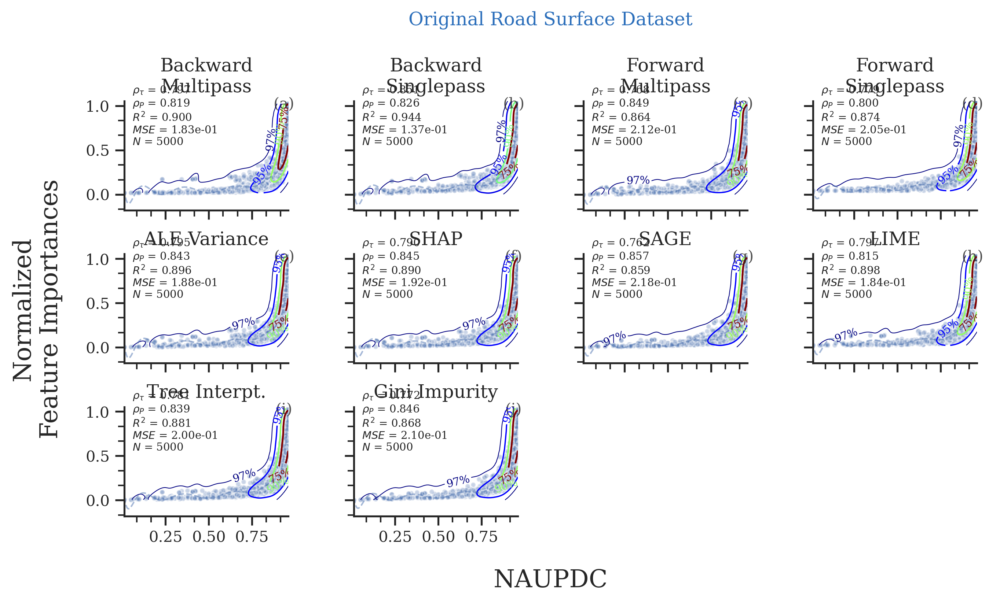

In [16]:
plot('road_surface', opt='original',)

### Reduced Road Surface Dataset

fname:  /work/mflora/explainability_work/datasets/importances_road_surface_reduced_unnormalized.pkl


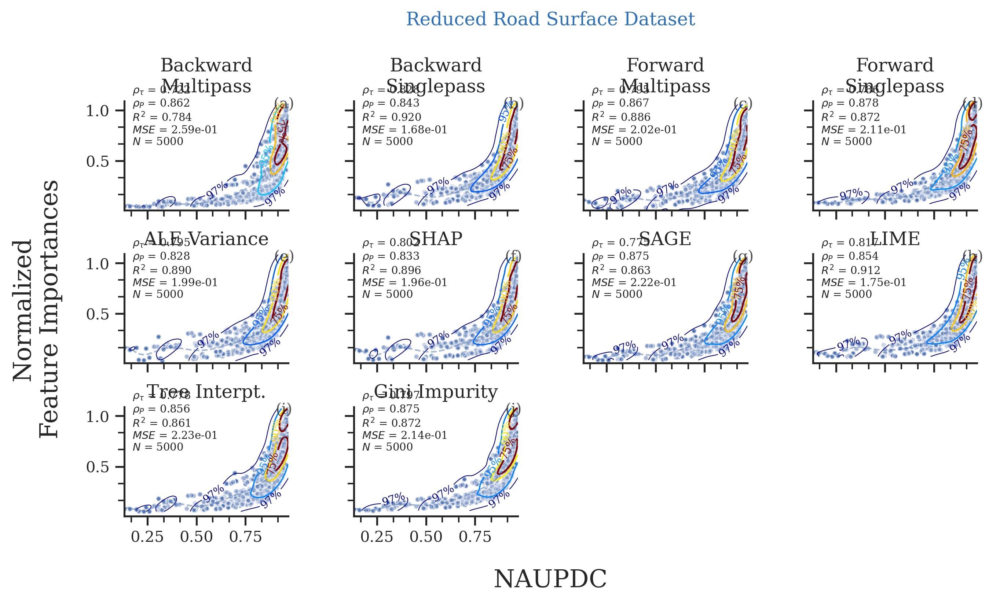

In [15]:
plot('road_surface', opt='reduced')

### Original Tornado Dataset

fname:  /work/mflora/explainability_work/datasets/importances_tornado__unnormalized.pkl


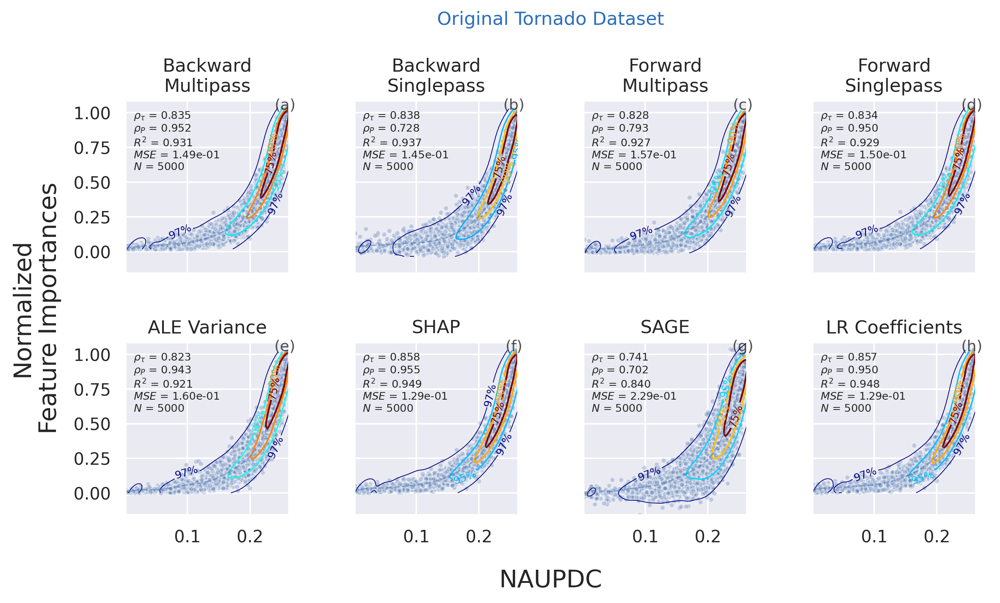

In [48]:
plot('tornado', opt='')

fname:  ../datasets/importances_tornado_L1_based_feature_selection_with_manual_unnormalized.pkl


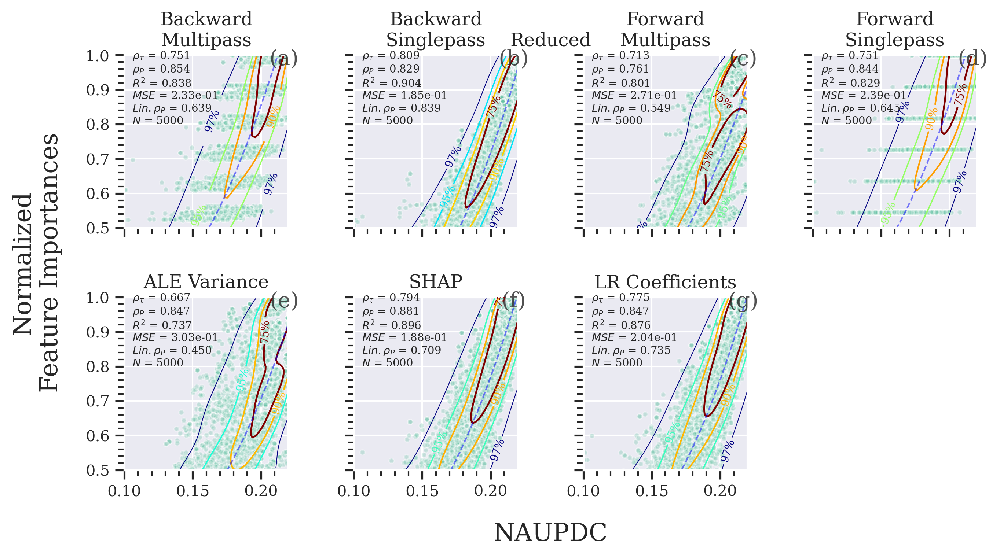

In [10]:
plot('tornado', ylims=[0.5, 1.0], xlims=[0.1, 0.22])

## Tornado, Reduced Feature Set (Normalized)

fname:  ../datasets/importances_tornado_L1_based_feature_selection_with_manual_normalized.pkl


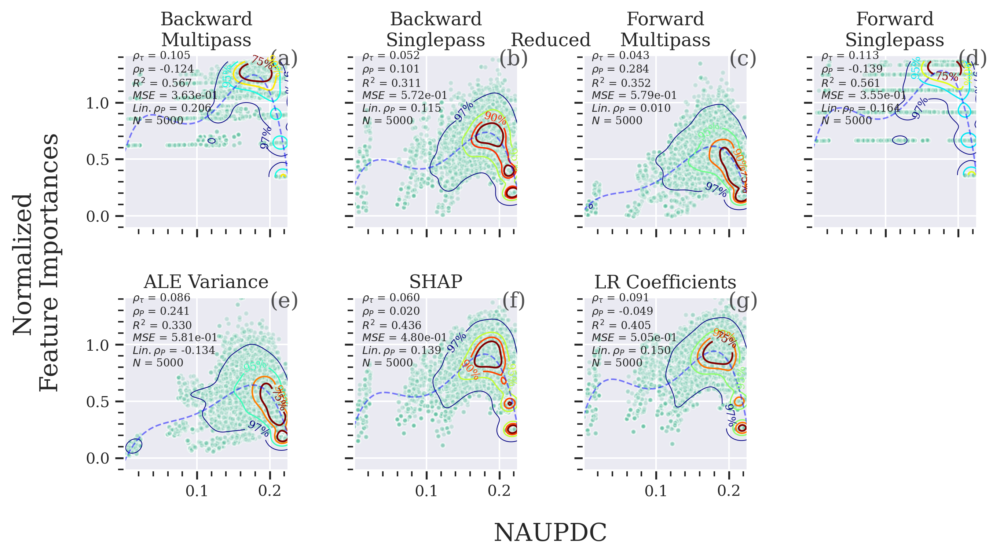

In [11]:
plot('tornado', method='normalized')

## Tornado, Reduced Feature Set (Normalized by Percent)

fname:  ../datasets/importances_tornado_L1_based_feature_selection_with_manual_normalized_divide.pkl


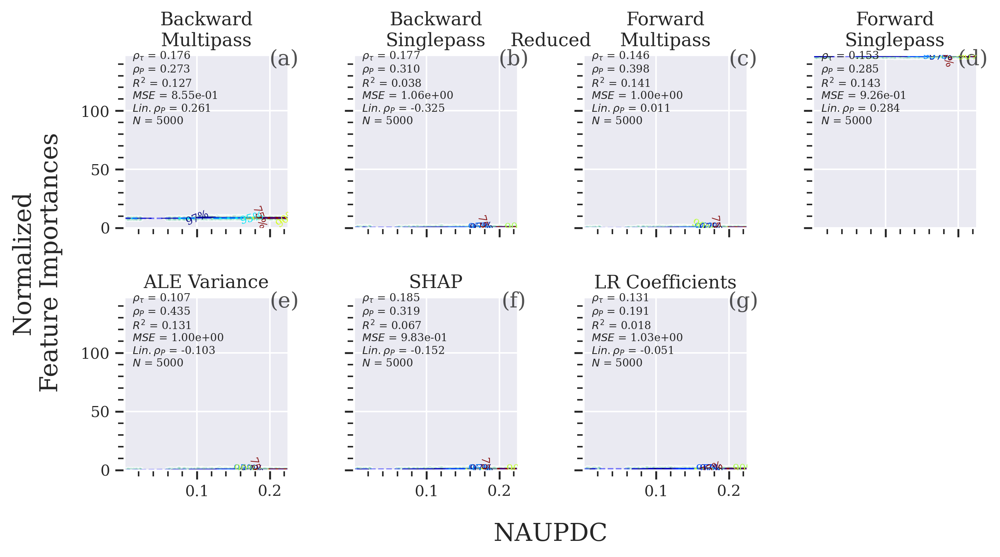

In [12]:
plot('tornado', method='normalized_divide')

## Tornado, Full Feature Set

fname:  ../datasets/importances_tornado__unnormalized.pkl


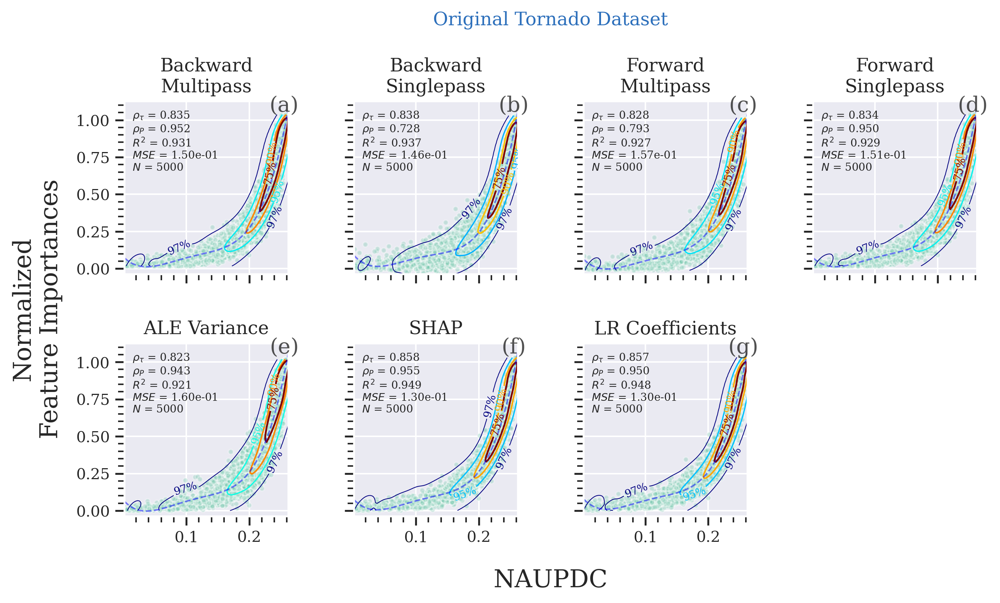

In [11]:
plot('tornado', opt='', )

fname:  ../datasets/importances_tornado__unnormalized.pkl


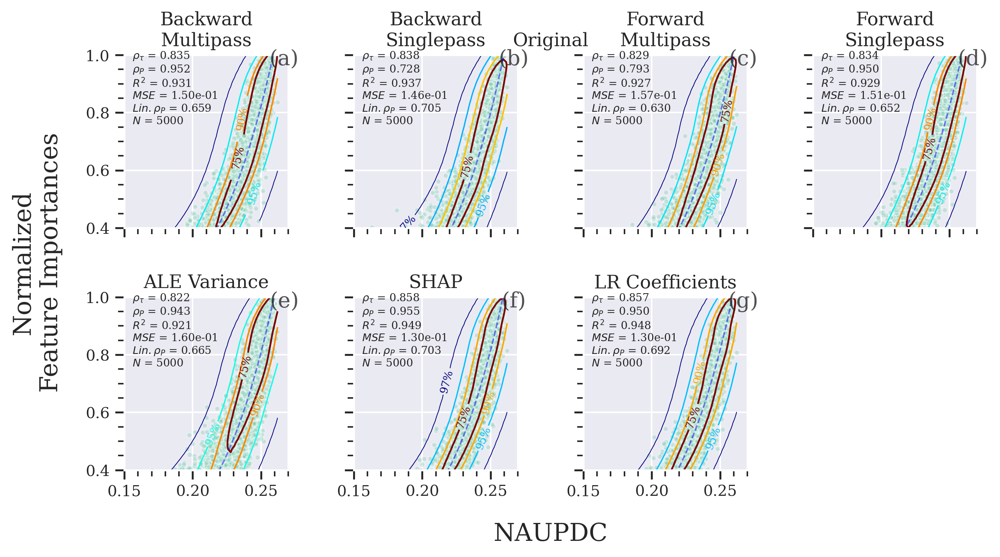

In [70]:
plot('tornado', opt='', ylims=[0.4, 1.0], xlims=[0.15, 0.27])

fname:  ../datasets/importances_tornado__normalized.pkl


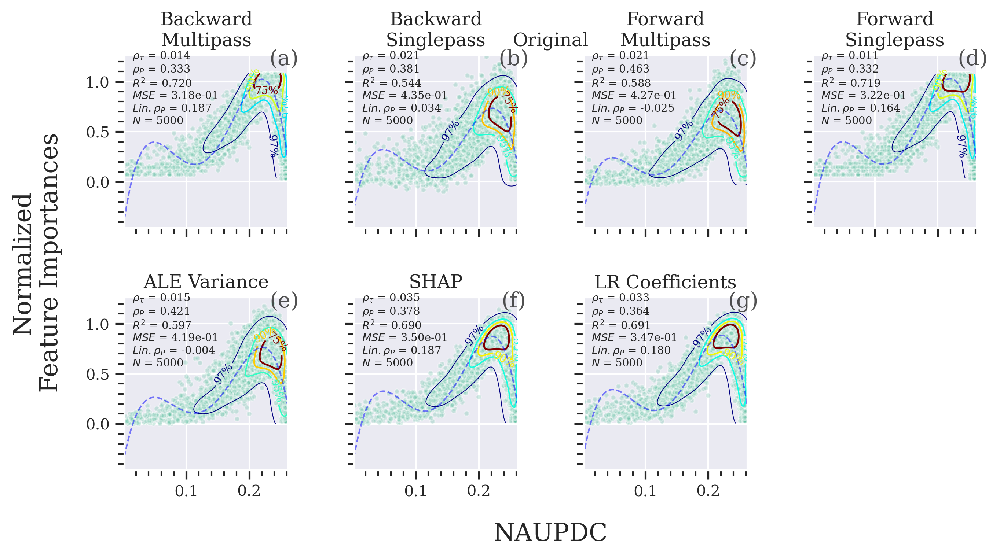

In [14]:
plot('tornado', opt='', method='normalized' )

fname:  ../datasets/importances_tornado__normalized_divide.pkl


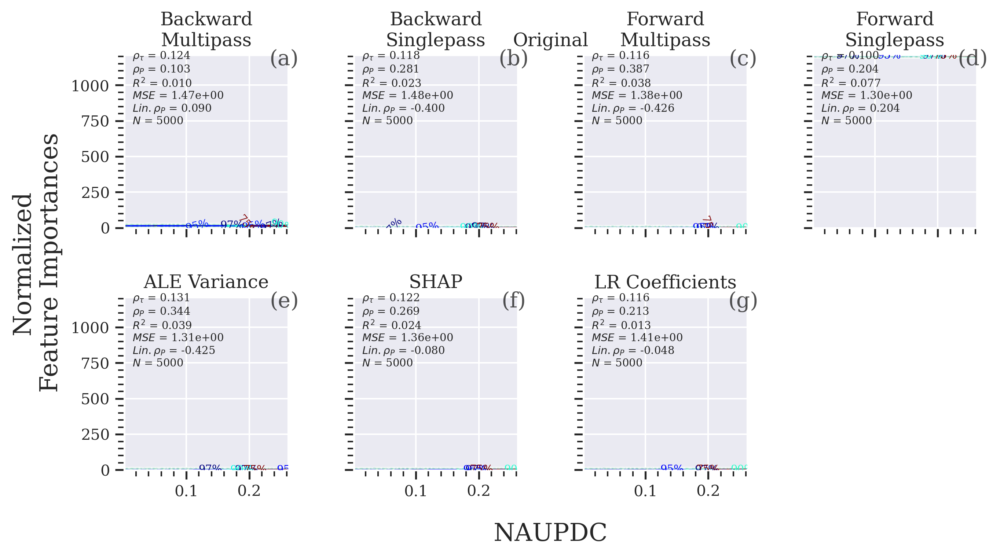

In [15]:
plot('tornado', opt='', method='normalized_divide' )

fname:  ../datasets/importances_tornado__unnormalized.pkl


invalid value encountered in log
invalid value encountered in log


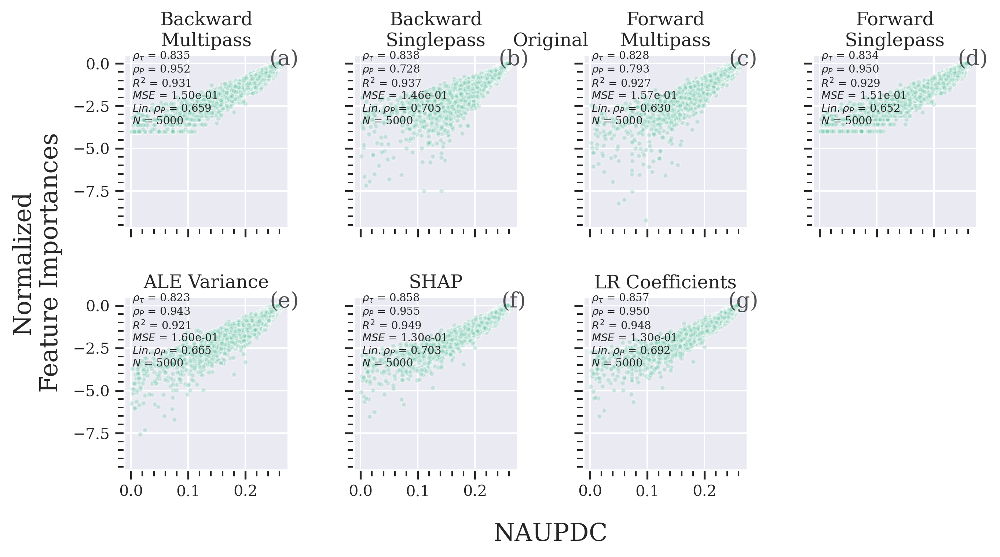

In [16]:
plot('tornado', opt='', plt_opt  = 'log')

## Hail , Reduced Feature Set

fname:  ../datasets/importances_severe_hail_L1_based_feature_selection_with_manual_unnormalized.pkl


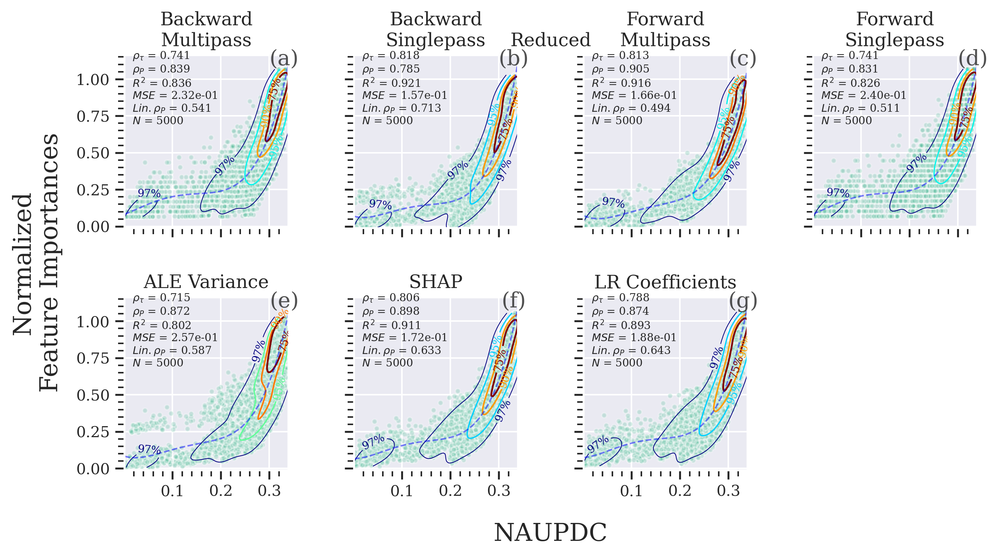

In [17]:
plot('severe_hail')

fname:  ../datasets/importances_severe_hail_L1_based_feature_selection_with_manual_unnormalized.pkl


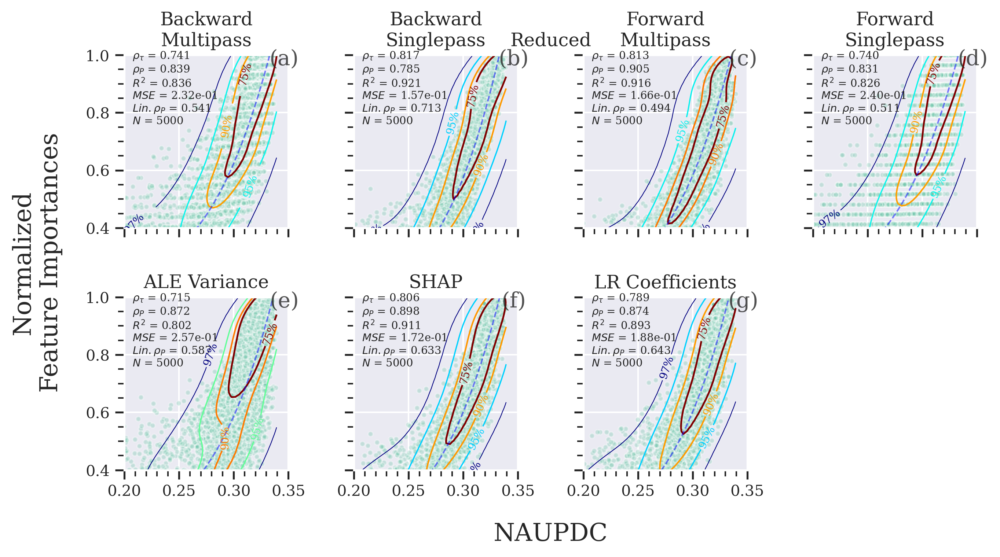

In [72]:
plot('severe_hail', ylims=[0.4, 1.0], xlims=[0.2, 0.35])

fname:  ../datasets/importances_severe_hail_L1_based_feature_selection_with_manual_unnormalized.pkl


invalid value encountered in log


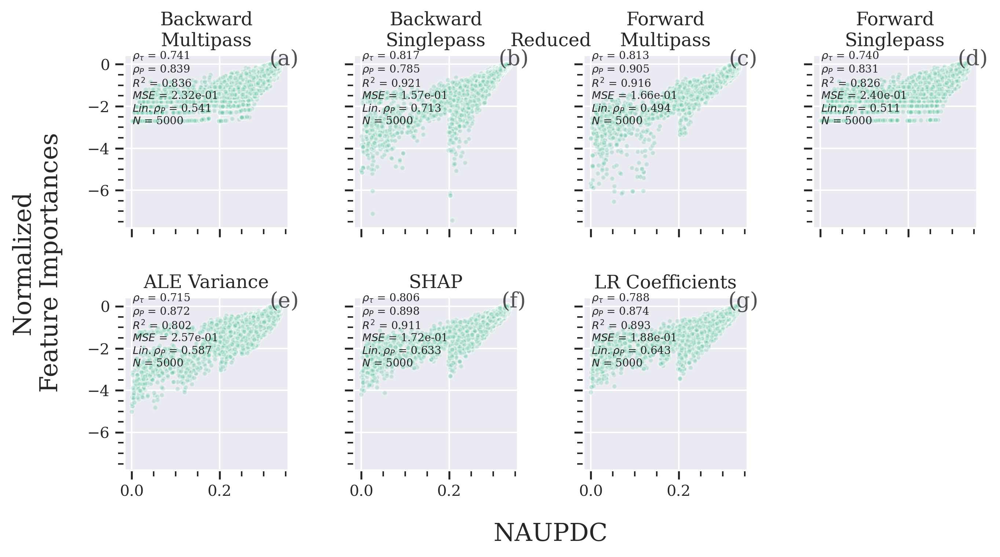

In [18]:
plot('severe_hail', plt_opt='log')

## Hail , Full Feature Set

fname:  /work/mflora/explainability_work/datasets/importances_severe_hail__unnormalized.pkl


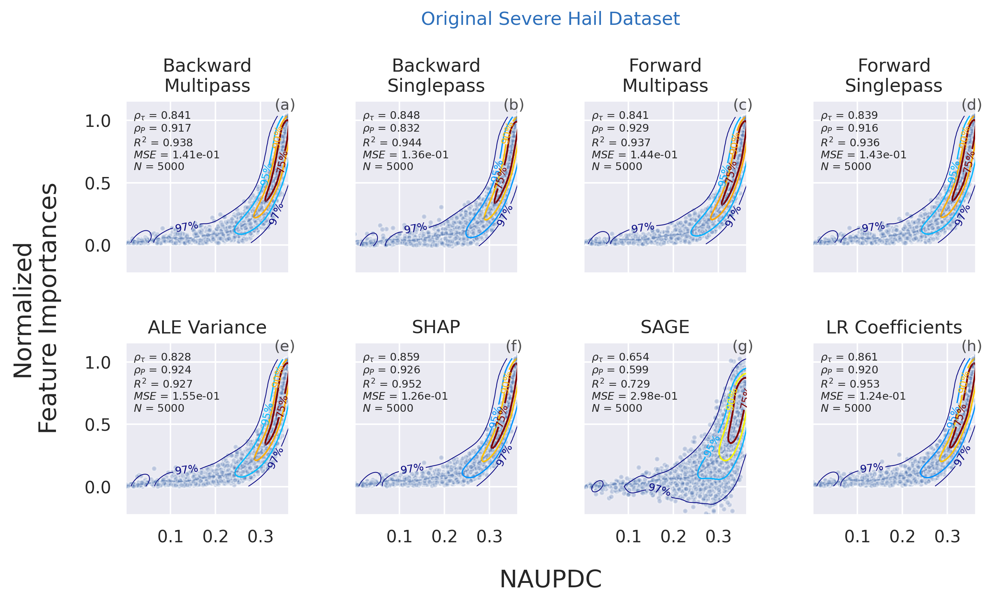

In [43]:
plot('severe_hail', opt='')

fname:  ../datasets/importances_severe_hail__normalized_divide.pkl


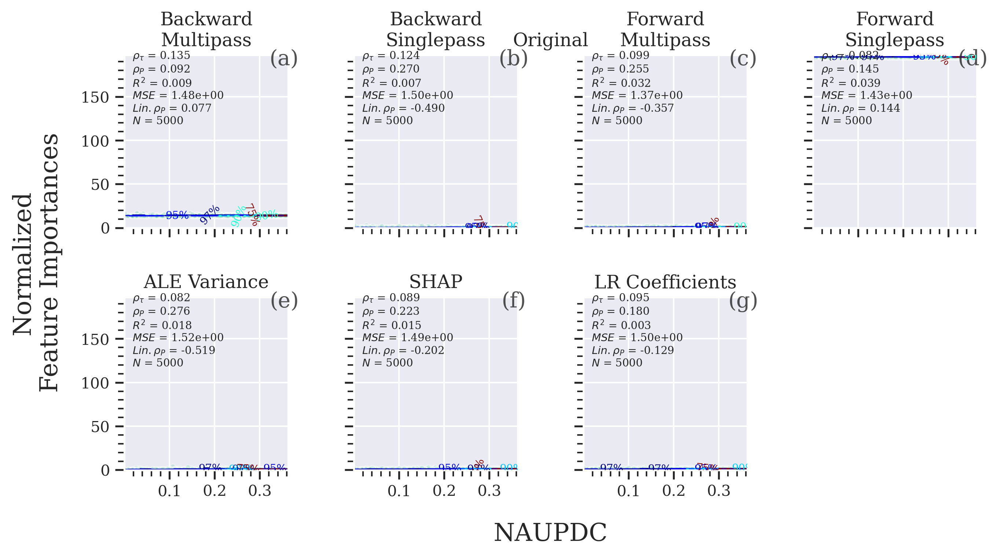

In [20]:
plot('severe_hail', opt='', method='normalized_divide')

fname:  ../datasets/importances_severe_hail__unnormalized.pkl


invalid value encountered in log


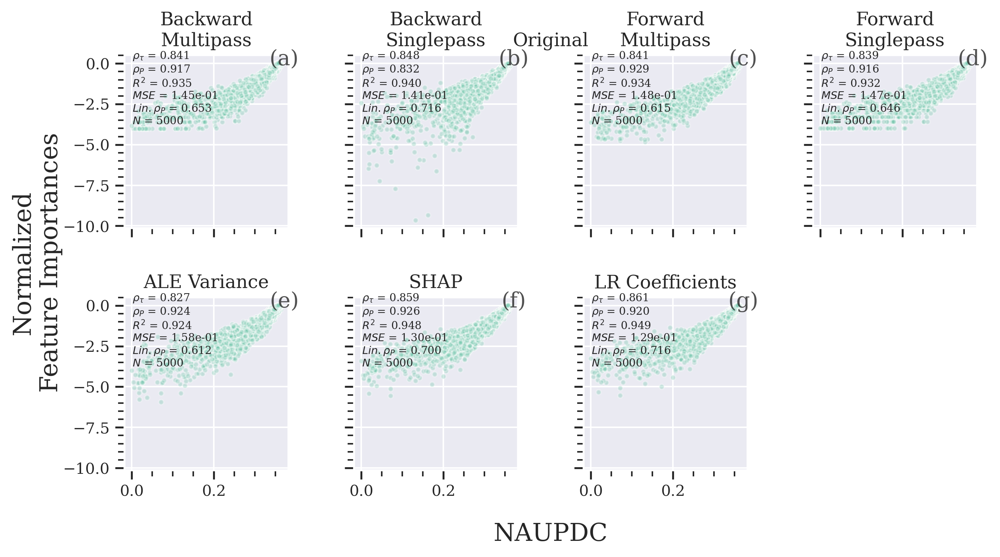

In [21]:
plot('severe_hail', opt='', plt_opt='log')

## Wind , Reduced Feature Set

fname:  ../datasets/importances_severe_wind_L1_based_feature_selection_with_manual_unnormalized.pkl


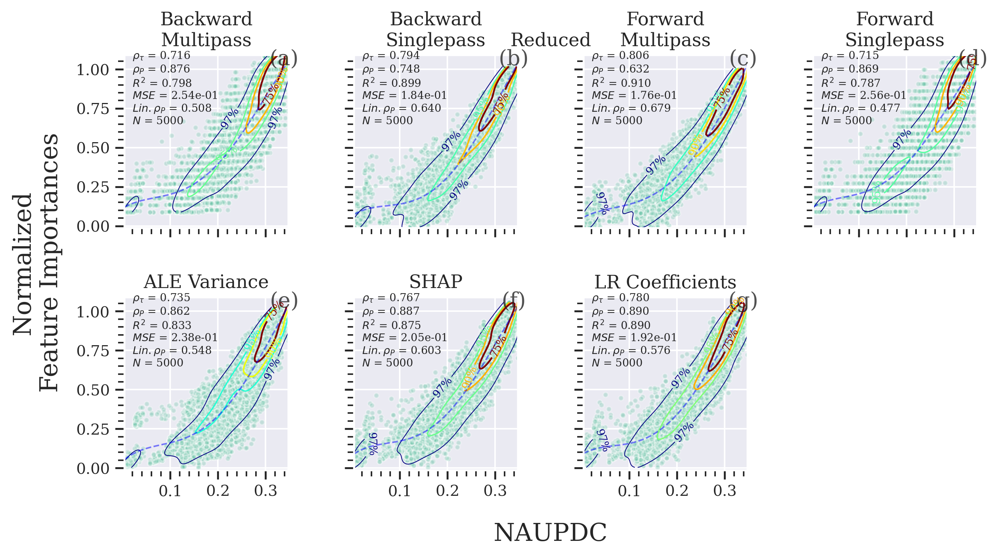

In [22]:
plot('severe_wind')

## Wind , Full Feature Set

fname:  /work/mflora/explainability_work/datasets/importances_severe_wind__unnormalized.pkl


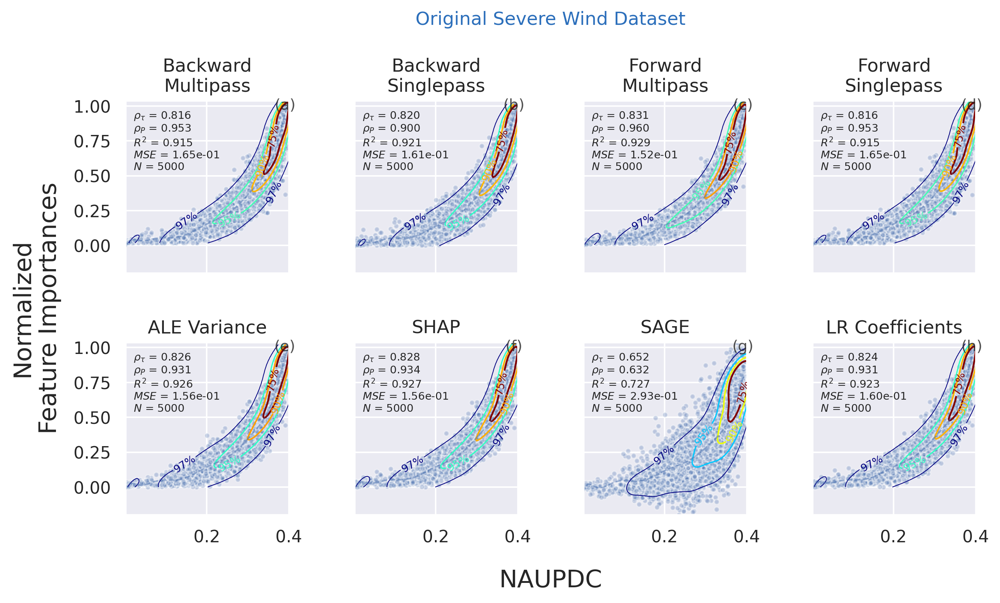

In [44]:
plot('severe_wind', opt='',)# xlims=[0.2, 0.4], ylims=[0.5, 1.1], )

fname:  ../datasets/importances_severe_wind__unnormalized.pkl


invalid value encountered in log


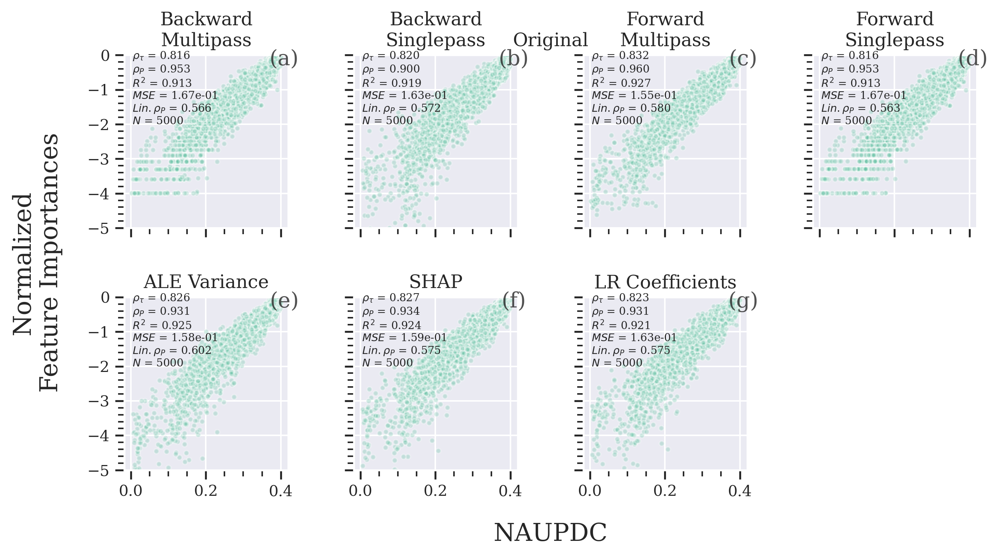

In [24]:
plot('severe_wind', opt='', plt_opt='log', ylims=[-5, 0])

In [24]:
def indicate_outliers(ax, x, y, method='SAGE', thresh=0.8, color='k', s=30, label='', 
                       alpha=0.8, edgecolor='k'):
    x_new = x[y>thresh]
    y_new = y[y>thresh]

    try:
        x_ = x[y<=thresh][0]
        y_ = y[y<=thresh][0]
    except:
        ax.scatter(x,y, color =colors_dict[method], s=s, label=label, 
                       alpha=alpha, edgecolor='k')
        return None
    
    ax.scatter(x_new, y_new, color =colors_dict[method], s=30, label=label, 
                       alpha=alpha, edgecolor='k')
    ymin, ymax = ax.get_ylim()
    xmin, xmax = ax.get_xlim()
    
    xm = xmin*0.985
    ym = ymin*0.985
    
    ax.scatter([xm], [ym])

    ax.set_ylim([ym, ymax])
    ax.set_xlim([xm, xmax])
    ax.annotate(f"{method.upper()}=({x_:.3f},{y_:.3f})", xy=(xm*1.0001, ym*1.0001), fontsize=8,
                color='darkkhaki')
    

def set_legend(n_panels, fig, ax, major_ax, ncol = 3, bbox_to_anchor=(0.5, -0.35)):
        """
        Set a single legend on the bottom of a figure
        for a set of subplots.
        """
        handles, labels = ax.get_legend_handles_labels()

        # Shrink current axis's height by 10% on the bottom
        box = major_ax.get_position()
        major_ax.set_position(
            [box.x0, box.y0 + box.height * 0.1, box.width, box.height * 0.9]
        )

        # Put a legend below current axis
        major_ax.legend(
            handles,
            labels,
            loc="lower center",
            bbox_to_anchor=bbox_to_anchor,
            fancybox=True,
            shadow=True,
            ncol=ncol,
        )

        
import matplotlib.ticker as ticker
def plot_scatter(imp_method='unnormalized', x='cc', y='r2', correct_ax=True):
    
    targets=['tornado', 'severe_hail', 'severe_wind', 'road_surface',
             'tornado', 'severe_hail', 'severe_wind', 'road_surface'
            ]
    
    fig, axes = base_plt.create_subplots(n_panels=8, n_columns=4, figsize=(10,5), dpi=300, 
                                      wspace=0.5, hspace=0.3, sharex=False, sharey=False)
    ax_iter = axes.flat

    i = 0
    for k, (ax, target) in enumerate(zip(ax_iter, targets)):
        
        if correct_ax:
        
            #ax.set_ylim([0.65, 1.0])
            #ax.set_xlim([0.65, 1.0])

            if k < 4:
                ax.set_ylim([0.65, 1.0])
                ax.set_xlim([0.65, 1.0])
            
            else:
                ax.set_ylim([0.80, 1.0])
                ax.set_xlim([0.80, 1.0])

            xx = np.linspace(0,1)
        
            ax.plot(xx, xx, color='grey', ls='dashed', lw=1.0 )
                
        base_plt.set_minor_ticks(ax)
    
        opt = 'L1_based_feature_selection_with_manual' if k > 3 else ''
        if target == 'road_surface':
            opt = 'original' if opt == '' else 'reduced'
        
        fname = join(DATA_BASE_PATH, f'importances_{target}_{opt}_{imp_method}.pkl')

        print('fname: ', fname)
        with open(fname, 'rb') as f:
            results = pickle.load(f)  
            
            
            
        scores = np.array(results['scores'])
        importances = results['importances']
        methods = rf_methods if target == 'road_surface' else lr_methods
        
        #if k < 3:
        #    axins = ax.inset_axes([0.3, 0.2, 0.55, 0.55])
        #    axins.tick_params(axis='both', labelsize=7)
        #    axins.set_xlim(0.75, 0.90)
        #    axins.set_ylim(0.9, 0.96)
        
        for method in methods:
            imp = importances[method]
            imp = imp / (np.percentile(imp, 99) - np.percentile(imp,1))
            
            
            cc_mean, cc_std, _ = get_correlation(scores, imp, N_BOOT,)
            r2, mse, rho_linear, lin_cc, lin_r2 = do_curve_fit(X_orig=scores, y_orig=imp, N_BOOT=N_BOOT)
   
            data = {'r2' : r2, 
                    'mse' : mse,
                    'rho_linear' : rho_linear, 
                    'lin_cc' : lin_cc, 
                    'lin_r2' : lin_r2, 
                    'cc' : cc_mean
                   }
            

            label = pretty[method]
            if 'Gini' in label:
                label += '/LR Coefs'

            if k < 3:  
                indicate_outliers(ax, data[x], data[y], method=method, thresh=0.85, 
                                  color=colors_dict[method], label=label, s=30, alpha=0.8, edgecolor='k')
            else:
                ax.scatter(data[x], data[y], color =colors_dict[method], s=30, label=label, 
                       alpha=0.8, edgecolor='k')
            
            #if k < 3:
            #    axins.scatter(cc_mean, r2, color =colors_dict[method], s=20, label=label, 
            #           alpha=0.9, edgecolor='k')

        if k <= 3:
            ax.set_title(target.replace('_', ' ').title())
    
        #if k < 3:
        #    ax.indicate_inset_zoom(axins, edgecolor="black")
    
    
    labels = {'r2' : r'Coefficient of Determination ($R^2$)', 
              'mse' : 'MSE',
              'rho_linear' : 'Linear Correlation\n(after Log-Transform)', 
              'lin_cc' : "Linear Correlation\n(Imp. > 0.5)", 
              'lin_r2' : "Coefficient of Determination ($R^2$)\n(Imp. > 0.5)", 
              'cc' : r"Kendall Rank Correlation ($\rho_\tau$)"
                   }
    
    major_ax = base_plt.set_major_axis_labels(fig, xlabel=labels[x], 
                                              ylabel_left=labels[y],
                                              labelpad=40
                                             )
    major_ax.grid(False)
    base_plt.add_alphabet_label(n_panels=8, axes=axes, pos=(0.975, 0.05), fontsize=12)
    labels = ['Original\nFeature Sets', 'Reduced\nFeature Sets']
    base_plt.set_row_labels(labels, 
                        axes, 
                        pos=-1, 
                        pad=1.15, 
                        rotation=270,
                       )
    ax.yaxis.set_label_position("right")
    
    """
    ax.annotate(
                'Original\nFeature Sets',
                xy=(1, 1),
                xytext=(1.20, 0.5),
                xycoords=ax.transAxes,
                rotation=270,
                size=14,
                ha="center",
                va="center",
                color="xkcd:darkish blue",
                alpha=0.65,
            )
    """
    set_legend(7, fig, ax,  major_ax, ncol=5, bbox_to_anchor=(0.5, -0.65))

fname:  /work/mflora/explainability_work/datasets/importances_tornado__unnormalized.pkl
fname:  /work/mflora/explainability_work/datasets/importances_severe_hail__unnormalized.pkl
fname:  /work/mflora/explainability_work/datasets/importances_severe_wind__unnormalized.pkl
fname:  /work/mflora/explainability_work/datasets/importances_road_surface_original_unnormalized.pkl
fname:  /work/mflora/explainability_work/datasets/importances_tornado_L1_based_feature_selection_with_manual_unnormalized.pkl
fname:  /work/mflora/explainability_work/datasets/importances_severe_hail_L1_based_feature_selection_with_manual_unnormalized.pkl
fname:  /work/mflora/explainability_work/datasets/importances_severe_wind_L1_based_feature_selection_with_manual_unnormalized.pkl
fname:  /work/mflora/explainability_work/datasets/importances_road_surface_reduced_unnormalized.pkl


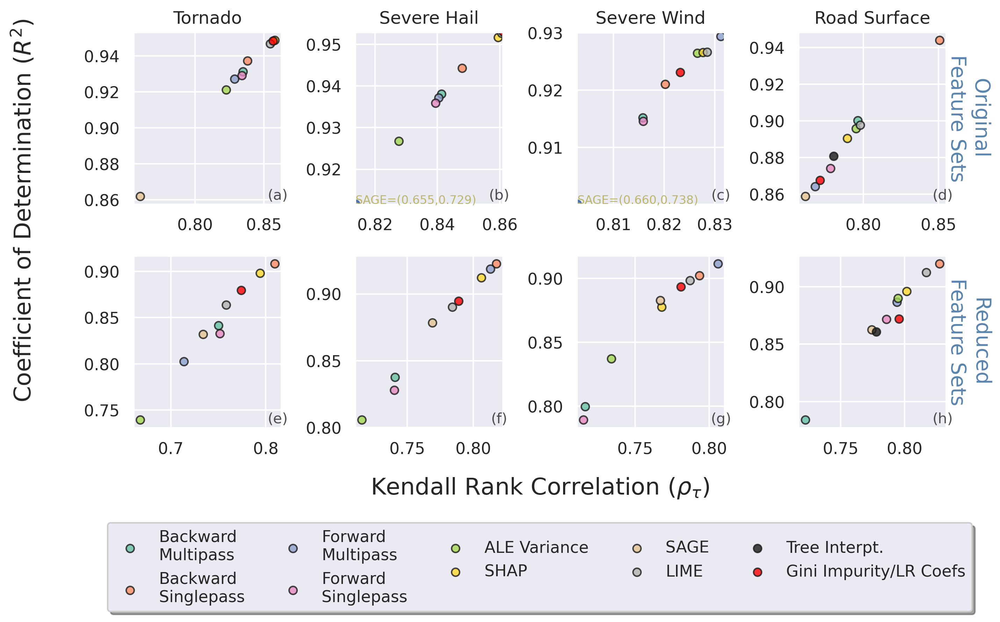

In [25]:
sns.set_theme()
plot_scatter(x='cc', y = 'r2', correct_ax=False)

fname:  ../datasets/importances_tornado__unnormalized.pkl
fname:  ../datasets/importances_severe_hail__unnormalized.pkl
fname:  ../datasets/importances_severe_wind__unnormalized.pkl
fname:  ../datasets/importances_road_surface_original_unnormalized.pkl
fname:  ../datasets/importances_tornado_L1_based_feature_selection_with_manual_unnormalized.pkl
fname:  ../datasets/importances_severe_hail_L1_based_feature_selection_with_manual_unnormalized.pkl
fname:  ../datasets/importances_severe_wind_L1_based_feature_selection_with_manual_unnormalized.pkl
fname:  ../datasets/importances_road_surface_reduced_unnormalized.pkl


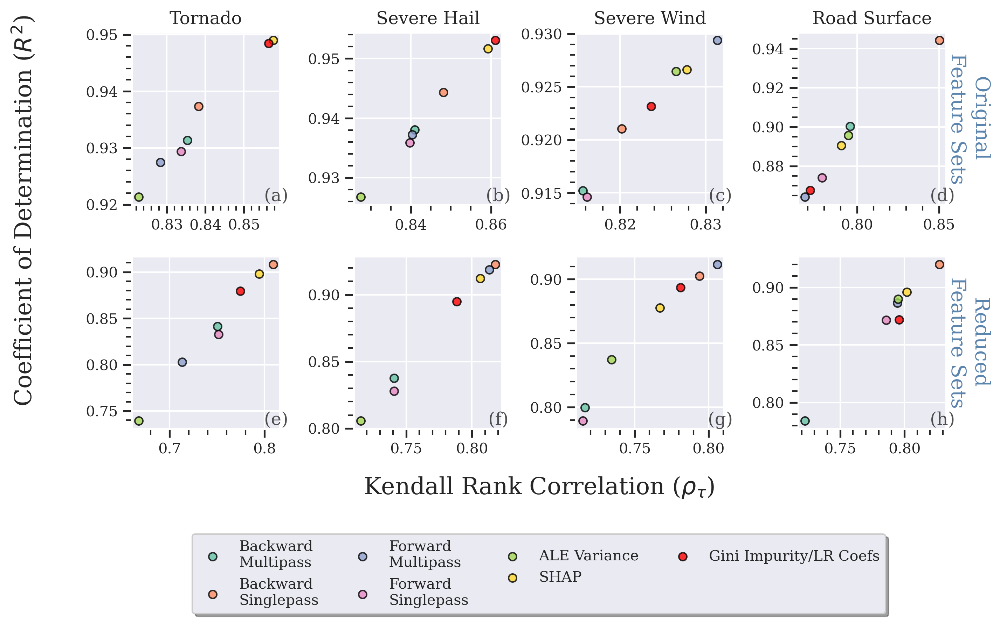

In [10]:
plot_scatter(x='cc', y = 'r2', correct_ax=False)

fname:  ../datasets/importances_tornado_L1_based_feature_selection_with_manual_unnormalized.pkl
fname:  ../datasets/importances_severe_hail_L1_based_feature_selection_with_manual_unnormalized.pkl
fname:  ../datasets/importances_severe_wind_L1_based_feature_selection_with_manual_unnormalized.pkl
fname:  ../datasets/importances_road_surface_reduced_unnormalized.pkl
fname:  ../datasets/importances_tornado__unnormalized.pkl
fname:  ../datasets/importances_severe_hail__unnormalized.pkl
fname:  ../datasets/importances_severe_wind__unnormalized.pkl


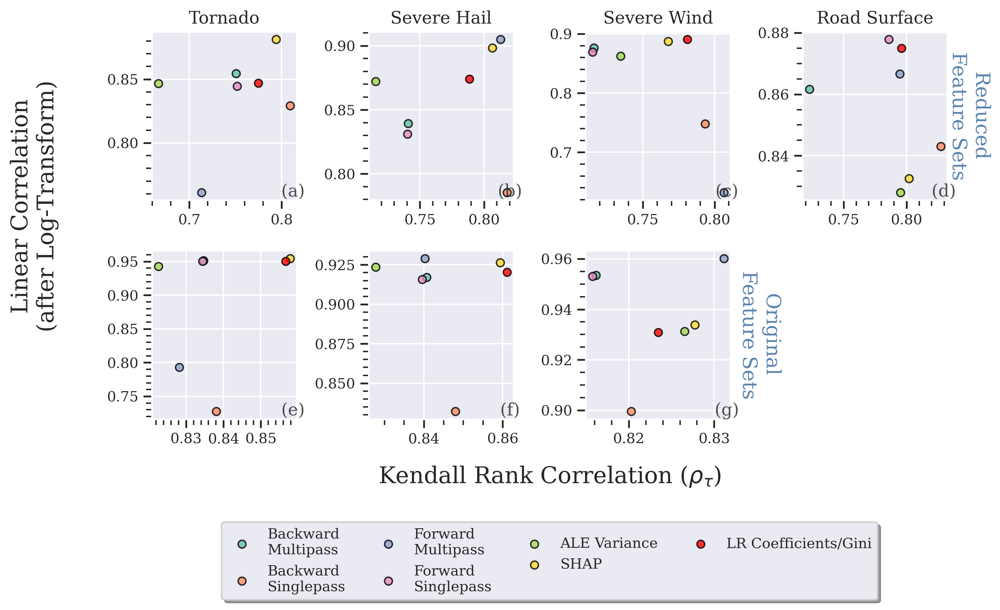

In [28]:
plot_scatter(x='cc', y = 'rho_linear', correct_ax=False)

## Experiment 2: Model performance on top 5 vs. bottom 5 predictors.

In [52]:
from scipy.ndimage import gaussian_filter

def plot_exp_2(target, opt='', method='unnormalized', methods=None):
    
    with open(join(DATA_BASE_PATH, f'top_worst_predictors_{target}_{opt}_scores.pkl'), 'rb') as f:
        results = pickle.load(f)

        
    if methods is None:    
        methods = rf_methods if target == 'road_surface' else lr_methods
    
    fname = join(DATA_BASE_PATH, f'importances_{target}_{opt}_{method}.pkl')
    with open(fname, 'rb') as f:
            data = pickle.load(f)     
    feature_importances = data['feature_importances']
    
    fig, axes = base_plt.create_subplots(n_panels = 2, 
                                   n_columns= 2, figsize=(11,3), 
                                   dpi=300, wspace=0.2, hspace=0.1, sharey=True)

    for ax, score_key, title in zip(axes.flat, ['top_scores', 'bottom_scores'], 
                                ['Most Importance Predictors\n(Higher scores better)', 
                                 'Least Important Predictors\n(Lower scores better)'] ):
        
        for m in methods:
            ds_temp = results[m][score_key]            
            scores_temp = np.array([y['naupdc'].values for y in ds_temp])
            mean_val = np.mean(scores_temp, axis=1)
            bottom_val = np.percentile(scores_temp, 2.5, axis=1)
            top_val = np.percentile(scores_temp, 97.5, axis=1)

            ax.plot(range(len(scores_temp)), mean_val, 
                    label=pretty[m], lw=1.2, alpha=0.9, color=colors_dict[m], )
            
            #ax.fill_between(range(len(scores_temp)), bottom_val, top_val, color = colors_dict[m], alpha=0.3, 
            #               lw=0.01, )

        ax.set_title(title)
        ax.set_xticks(np.arange(len(scores_temp)))
        ax.set_xticklabels(np.arange(len(scores_temp))+1)

        
    major_ax = base_plt.set_major_axis_labels(fig, xlabel='Num. of Features', 
                               ylabel_left='NAUPDC', 
                              )
    major_ax.grid(False)

    base_plt.add_alphabet_label(n_panels=2, axes=axes, pos=(0.09, 0.9), fontsize=16)
    set_legend(n_panels=2, 
               fig=fig, 
               ax=ax, 
               major_ax=major_ax, ncol=4, bbox_to_anchor=(0.5, -0.8))

# Comparing Highest vs. Lowest Ranked Features

# Tornado

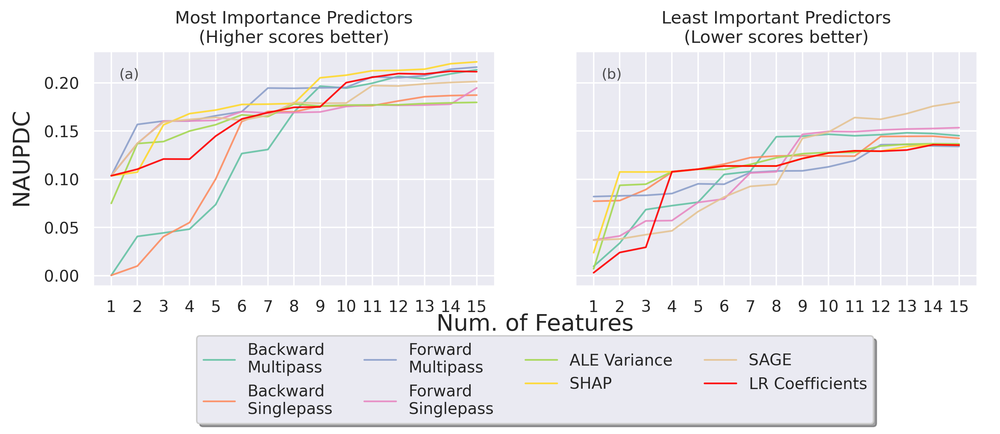

In [53]:
plot_exp_2('tornado')

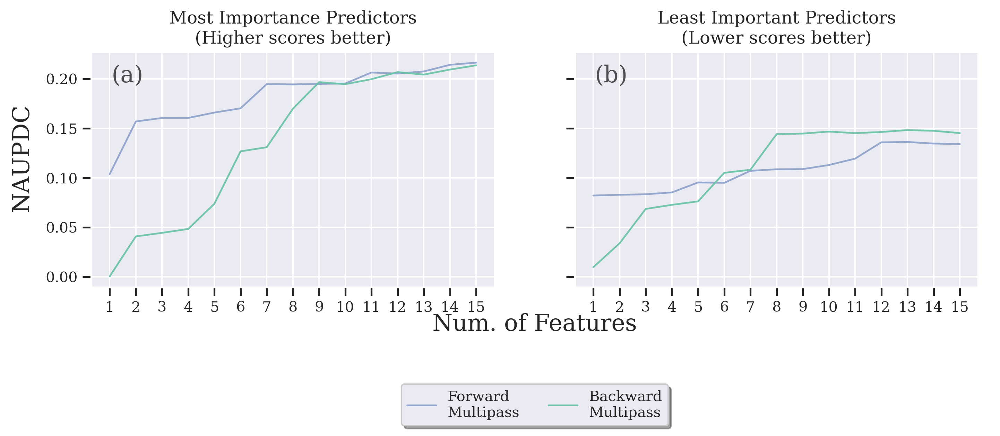

In [67]:
plot_exp_2('tornado',  methods=['multipass__forward', 'multipass__backward'] )

# Severe Hail

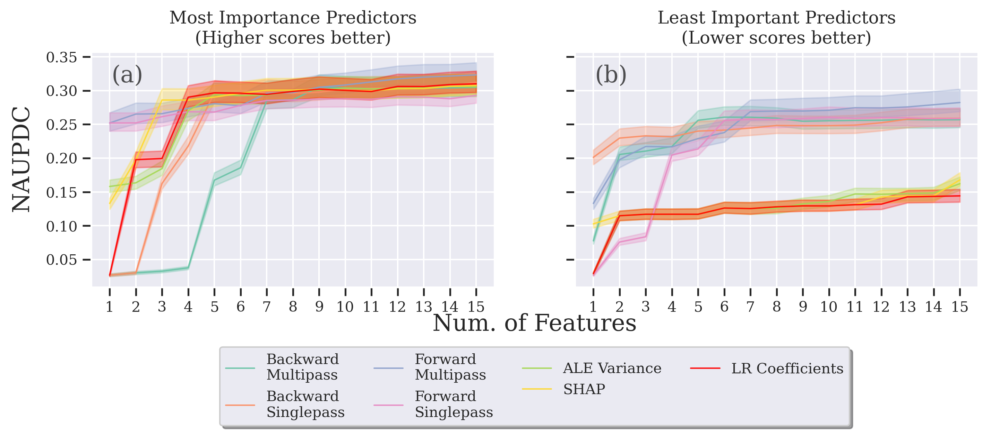

In [42]:
plot_exp_2('severe_hail')

# Severe Wind

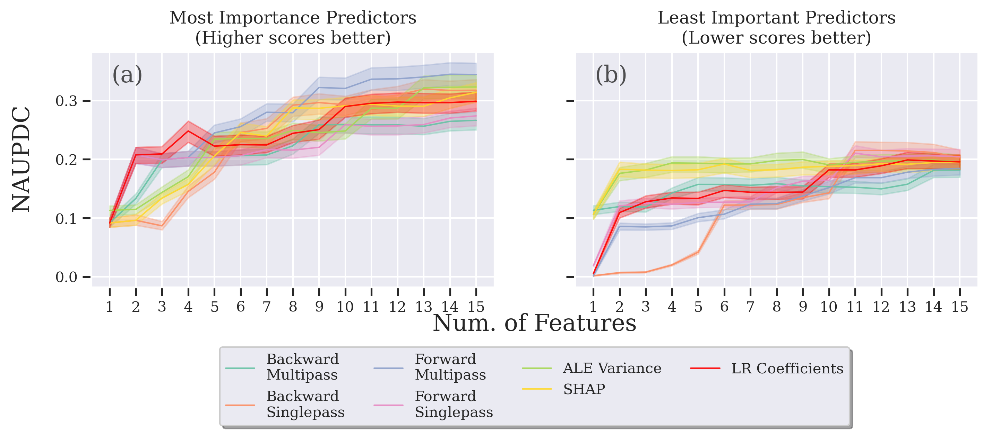

In [43]:
plot_exp_2('severe_wind')

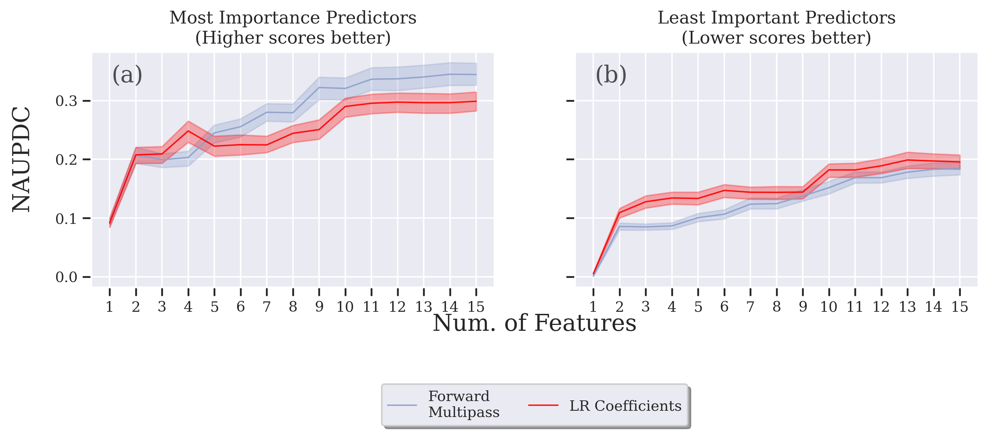

In [44]:
plot_exp_2('severe_wind', methods=['multipass__forward', 'coefs'])

In [46]:
from mlxtend.evaluate import permutation_test
def get_p_values(data, methods):
    p_values=[]
    x=data[0, :]
    for j, m in enumerate(methods[1:]):
        y=data[j+1, :]
        p_value = permutation_test(x=x,y=y,func='x_mean != y_mean',method='approximate', num_rounds=5000, seed=123)
        p_values.append(p_value)

    return np.array(p_values)

def barplot_annotate_brackets(ax, num1, num2, data, center, 
                              height, yerr=None, dh=.1, barh=.05, fs=None, maxasterix=None):
    """ 
    Annotate barplot with p-values.

    :param num1: number of left bar to put bracket over
    :param num2: number of right bar to put bracket over
    :param data: string to write or number for generating asterixes
    :param center: centers of all bars (like plt.bar() input)
    :param height: heights of all bars (like plt.bar() input)
    :param yerr: yerrs of all bars (like plt.bar() input)
    :param dh: height offset over bar / bar + yerr in axes coordinates (0 to 1)
    :param barh: bar height in axes coordinates (0 to 1)
    :param fs: font size
    :param maxasterix: maximum number of asterixes to write (for very small p-values)
    """

    if type(data) is str:
        text = data
    else:
        # * is p < 0.05
        # ** is p < 0.005
        # *** is p < 0.0005
        # etc.
        text = ''
        p = .05

        while data < p:
            text += '*'
            p /= 10.

            if maxasterix and len(text) == maxasterix:
                break

        if len(text) == 0:
            text = 'n. s.'

    lx, ly = center[num1], height[num1]
    rx, ry = center[num2], height[num2]

    if yerr:
        ly += yerr[num1]
        ry += yerr[num2]

    ax_y0, ax_y1 = plt.gca().get_ylim()
    dh *= (ax_y1 - ax_y0)
    barh *= (ax_y1 - ax_y0)

    y = max(ly, ry) + dh

    barx = [lx, lx, rx, rx]
    bary = [y, y+barh, y+barh, y]
    mid = ((lx+rx)/2, y+barh)

    ax.plot(barx, bary, c='grey', alpha=0.8)

    kwargs = dict(ha='center', va='bottom')
    kwargs['color'] = 'grey'
    if fs is not None:
        kwargs['fontsize'] = fs

    ax.text(*mid, text, **kwargs)


def plot_exp_3(opt='', method='unnormalized'):
    
    targets = ['tornado', 'severe_hail', 'severe_wind', 'road_surface']
    f, axes = base_plt.create_subplots(n_panels=3, n_columns=3, figsize=(10,4), dpi=300, 
                                      wspace=0.25, sharey=True)
    
    i=0
    for ax, target in zip(axes.flat, targets):
    
        with open(join(DATA_BASE_PATH, f'top_worst_predictors_{target}_{opt}_scores.pkl'), 'rb') as f:
            results = pickle.load(f)

        fname = join(DATA_BASE_PATH, f'importances_{target}_{opt}_{method}.pkl')
        with open(fname, 'rb') as f:
            data = pickle.load(f)     
        feature_importances = data['feature_importances']

        colors_dict = {mapper[m] : c for m,c in zip(feature_importances.keys(), sns.color_palette("Set2"))}
        
        diff =[]
        methods = []
        for m in feature_importances.keys():
            size = len(results[m]['top_scores'])
            
            top_scores = np.array([results[m]['top_scores'][i]['naupdc'].values for i in range(size)])
            bottom_scores = np.array([results[m]['bottom_scores'][i]['naupdc'].values for i in range(size)]) 
            # (15, 100)
            score = np.mean(top_scores, axis=0) - np.mean(bottom_scores, axis=0)
            score /= np.mean(top_scores, axis=0)
            
            diff.append(score)
            ###diff.append(top_scores - bottom_scores)
        
            methods.append(mapper[m])
        
        diff_mean = np.mean(diff, axis=1)
        diff_std = np.abs(diff_mean - np.nanpercentile(diff, [2.5, 97.5], axis=1))
   
        inds = np.argsort(diff_mean)[::-1]

        diff_sorted = np.array(diff_mean)[inds]
        diff_std_sorted = np.array(diff_std)[:, inds]
        methods_sorted = np.array(methods)[inds]

        data_sorted = np.array(diff)[inds]
        
        p_vals = get_p_values(data_sorted, methods_sorted)
        
        colors = [colors_dict[m] for m in methods_sorted]
        bars = np.arange(len(diff_sorted))
        heights = diff_sorted
        ax.bar(bars, heights, color=colors, yerr=diff_std_sorted, capsize=2.9)
        
        # Denote the significance between the first pair 
        #barplot_annotate_brackets(ax, 0, 1, p_vals[0], bars, heights, fs=11, dh=0.01, barh=0.025)
        # Denote 
        #if any(p_vals[1:]<0.01):
        #    ind = np.argmax(p_vals[1:]<0.01)
        #    barplot_annotate_brackets(ax, 0, ind+2, p_vals[ind+1], bars, heights, fs=11, dh=0.025, barh=0.025)
        
        
        ax.set_xticks(np.arange(len(diff)))
        ax.set_xticklabels(methods_sorted, rotation=90, fontsize=9)
        ax.set_title(target.replace('_', ' ').title())
        if i == 0:
            ax.set_ylabel(r'$\Delta$'+' NAUPDC\n(Higher is Better)', fontsize=10)
            i+=1
        
        for i, _ in enumerate(methods_sorted):
            ax.get_xticklabels()[i].set_color(colors[i])

    base_plt.add_alphabet_label(n_panels=3, axes=axes, pos=(0.9, 0.9), fontsize=16)

## Figure 9. 

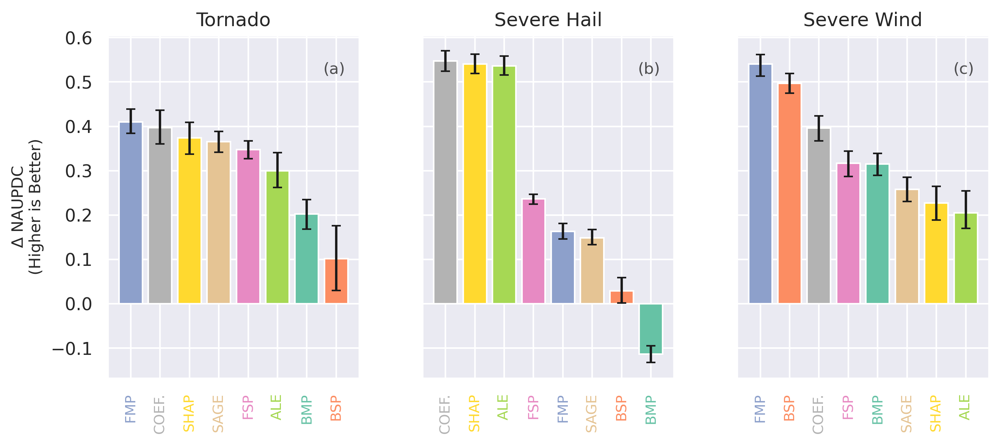

In [55]:
sns.set_theme()
plot_exp_3()

In [ ]:
##plot_exp_3(opt='L1_based_feature_selection_with_manual')

In [ ]:
def plot_exp_5(opt=''):

    targets = ['tornado', 'severe_hail', 'severe_wind', 'road_surface'] * 2

    fig, axes = base_plt.create_subplots(n_panels=8, n_columns=4, figsize=(15,8), dpi=300, 
                                      wspace=0.2, hspace=0.5,)
    j = 0
    for k, (ax, target) in enumerate(zip(axes.flat, targets)):
        opt = 'L1_based_feature_selection_with_manual' if k > 3 else ''
        
        if target == 'road_surface':
            opt = 'original' if opt == '' else 'reduced'

        fname = f'../datasets/top_predictors_{target}_{opt}_scores.pkl'
        print(f'Loading {fname}...')
        with open(fname, 'rb') as f:
            results = pickle.load(f)
        
        methods = rf_methods if target == 'road_surface' else lr_methods
        methods_pretty=[]
        
        scores = []
        for m in methods:
            naupdc_top = results[m]['top_scores'][0]['naupdc'].values
            naupdc_bottom = results[m]['bottom_scores'][0]['naupdc'].values
            delta_naupdc = naupdc_top - naupdc_bottom
            
            naupdc_top = results[m]['top_scores'][0]['naupdc'].values
            naupdc_bottom = results[m]['bottom_scores'][0]['naupdc'].values
            delta_naupdc = naupdc_top - naupdc_bottom
            
            scores.append(ds_temp['naupdc'].values)
            methods_pretty.append(mapper[m])
            
        diff_mean = np.mean(scores, axis=1)
        diff_std = np.abs(diff_mean - np.nanpercentile(scores, [2.5, 97.5], axis=1))

        inds = np.argsort(diff_mean)[::-1]
        scores_sorted = np.array(scores)[inds, :]
    
        diff_sorted = np.array(diff_mean)[inds]
        diff_std_sorted = np.array(diff_std)[:, inds]
        methods_sorted = np.array(methods_pretty)[inds]

        p_vals = get_p_values(scores_sorted, methods_sorted)
        
        colors = [colors_dict[m] for m in methods_sorted]
        bars = np.arange(len(diff_sorted))
        heights = diff_sorted
        ax.bar(bars, heights, color=colors, yerr=diff_std_sorted, capsize=2.9)
        
        # Denote the significance between the first pair 
        barplot_annotate_brackets(ax, 0, 1, p_vals[0], bars, heights, fs=11, dh=0.05, barh=0.05)
        # Denote 
        if any(p_vals[1:]<0.01):
            ind = np.argmax(p_vals[1:]<0.01)
            barplot_annotate_brackets(ax, 0, ind+2, p_vals[ind+1], bars, heights, fs=11, dh=0.1, barh=0.05)
        
        
        ax.set_xticks(np.arange(len(scores)))
        ax.set_xticklabels(methods_sorted, rotation=90, fontsize=9)
        if k <= 3:
            ax.set_title(target.replace('_', ' ').title())
        
        for i, _ in enumerate(methods_sorted):
            ax.get_xticklabels()[i].set_color(colors[i])
        
    base_plt.add_alphabet_label(n_panels=2, axes=axes, pos=(0.975, 0.975), fontsize=16)
    labels = ['Reduced\nFeature Sets', 'Original\nFeature Sets']
    base_plt.set_row_labels(labels, 
                        axes, 
                        pos=-1, 
                        pad=1.15, 
                        rotation=270,
                       )
    major_ax = base_plt.set_major_axis_labels(fig, xlabel=None, 
                               ylabel_left='NAUPDC', fontsize=16, labelpad=50,
                              )
    major_ax.grid(False)
    major_ax.set_xticks([])
    major_ax.set_yticks([])

In [47]:
#plot_exp_5()

In [48]:
def plot_scatter(opt=''):
    N_BOOT=100
    
    targets=['tornado', 'severe_hail', 'severe_wind', 'road_surface',]
    
    fig, axes = base_plt.create_subplots(n_panels=4, n_columns=2, figsize=(10,9), dpi=300, 
                                      wspace=0.2, hspace=0.3, sharex=True, )
    ax_iter = axes.flat
    
    i = 0
    for k, (ax, target) in enumerate(zip(ax_iter, targets)):
        #opt = '' if k > 3 else 'L1_based_feature_selection_with_manual'

        if target == 'road_surface':
            opt = 'original' if opt == '' else 'reduced'

        fname = f'../datasets/top_predictors_{target}_{opt}_scores.pkl'
        
        methods = rf_methods if target == 'road_surface' else lr_methods
        print(f'Loading {fname}...')
        with open(fname, 'rb') as f:
            results = pickle.load(f)

        for m in methods:
            naupdc_top = results[m]['top_scores'][0]['naupdc'].values
            naupdc_bottom = results[m]['bottom_scores'][0]['naupdc'].values
            delta_naupdc = 100.* ((naupdc_top - naupdc_bottom) / naupdc_top)
            
            bss_top = results[m]['top_scores'][0]['bss'].values
            bss_bottom = results[m]['bottom_scores'][0]['bss'].values
            delta_bss = 100.*((bss_top - bss_bottom) / bss_top)
            
            naupdc_mean = np.mean(delta_naupdc)
            bss_mean = np.mean(delta_bss)
            
            bss_err = np.abs(bss_mean - np.percentile(delta_bss, [2.5, 97.5])).reshape(2,1)
            naupdc_err = np.abs(naupdc_mean - np.percentile(delta_naupdc, [2.5, 97.5])).reshape(2,1)

            label = pretty[m]
            if 'G' in label:
                label += '\n/LR Coefs.'
            
            ax.errorbar(naupdc_mean, bss_mean, xerr=naupdc_err,
                        yerr=bss_err, fmt='o', color =colors_dict[m], 
                        capsize=2.0, elinewidth=0.5, label=label, alpha=0.6)
            
            ax.scatter(naupdc_mean, bss_mean, color =colors_dict[m],  alpha=0.6, edgecolor='k', 
                      zorder=10)
            base_plt.set_minor_ticks(ax)

        if k <= 3:
            ax.set_title(target.replace('_', ' ').title())
            
    major_ax = base_plt.set_major_axis_labels(fig, ylabel_left=r'$\Delta$ NAUPDC', 
                                              xlabel=r'$\Delta$ BSS',
                                              labelpad=50
                                             )
    major_ax.grid(False)
    base_plt.add_alphabet_label(n_panels=7, axes=axes, pos=(0.9, 0.05), fontsize=16)
    #labels = ['Reduced\nFeature Sets', 'Original\nFeature Sets']
    #base_plt.set_row_labels(labels, 
    #                   axes, 
    #                    pos=-1, 
    #                    pad=1.15, 
    #                    rotation=270,
    #                   )
    set_legend(8, fig, ax,  major_ax, ncol=4, bbox_to_anchor=(0.5, -0.35))

Loading ../datasets/top_predictors_tornado__scores.pkl...
Loading ../datasets/top_predictors_severe_hail__scores.pkl...
Loading ../datasets/top_predictors_severe_wind__scores.pkl...
Loading ../datasets/top_predictors_road_surface_original_scores.pkl...


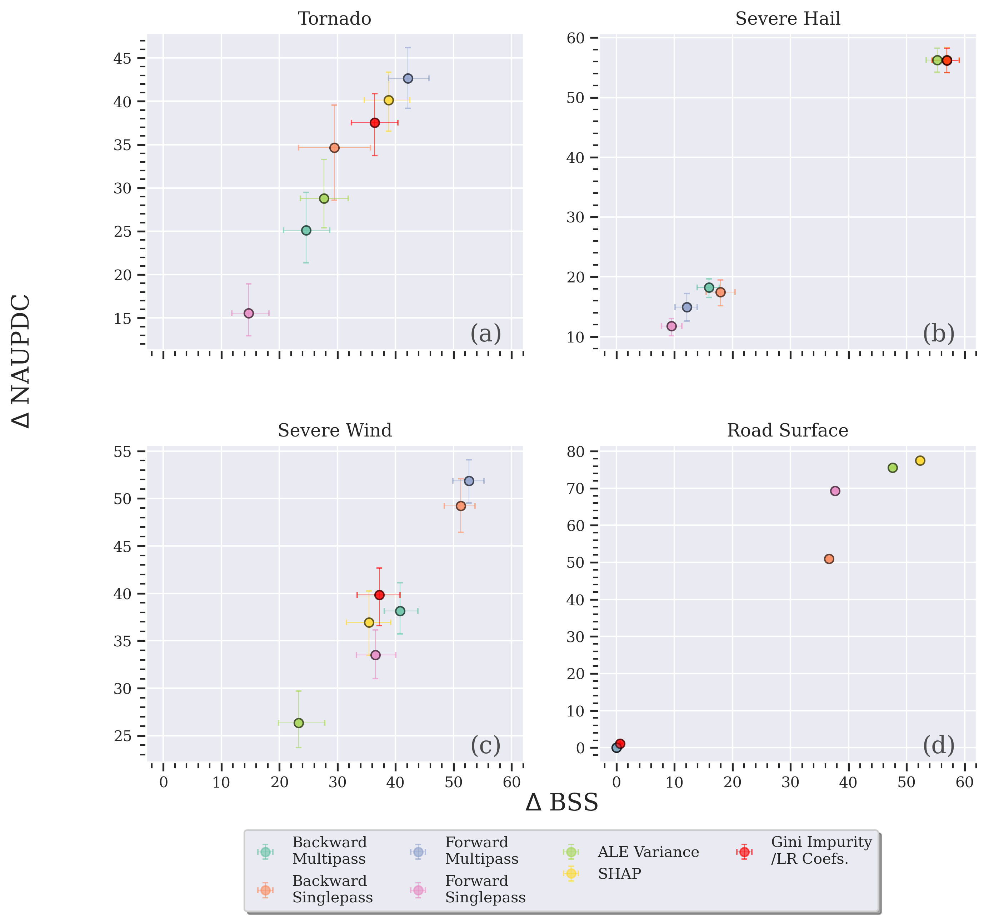

In [49]:
plot_scatter()

Loading ../datasets/top_predictors_tornado_L1_based_feature_selection_with_manual_scores.pkl...
Loading ../datasets/top_predictors_severe_hail_L1_based_feature_selection_with_manual_scores.pkl...
Loading ../datasets/top_predictors_severe_wind_L1_based_feature_selection_with_manual_scores.pkl...
Loading ../datasets/top_predictors_road_surface_reduced_scores.pkl...


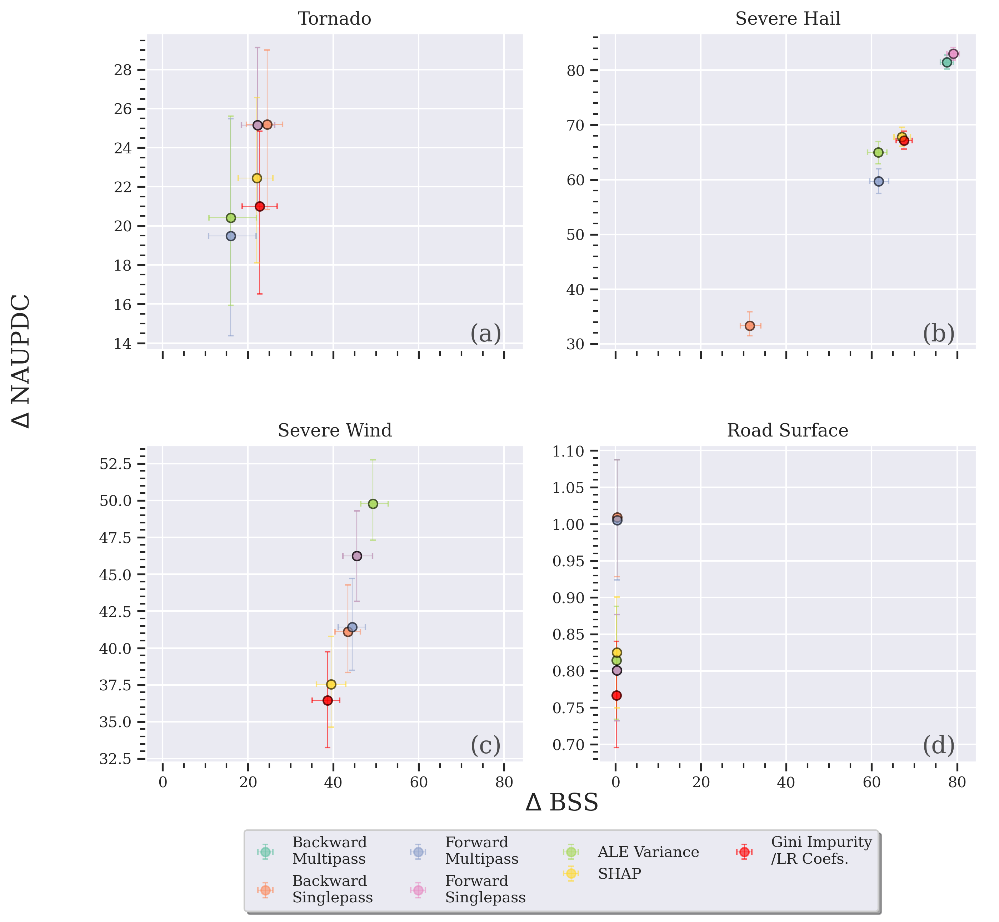

In [50]:
plot_scatter(opt='L1_based_feature_selection_with_manual')

In [51]:
def plot_exp_4(opt='L1_based_feature_selection_with_manual', 
               targets=['tornado', 'severe_hail', 'severe_wind', 'road_surface'],reverse=True ):
    
    
    targets=['tornado', 'severe_hail', 'severe_wind', 'road_surface',
             'tornado', 'severe_hail', 'severe_wind',
            ]
    
    title = '1 - Spearman rank-order Correlation' if reverse else 'Spearman rank-order Correlation'
    if len(targets) > 1:
        fig, axes = base_plt.create_subplots(n_panels=7, n_columns=4, figsize=(15,8), dpi=300, 
                                      wspace=0.2, hspace=0.5, sharey=True)
        ax_iter = axes.flat
    else:
        fig, axes = base_plt.create_subplots(n_panels=1,  figsize=(5,4), dpi=300,)
        ax_iter = [axes]
    
    i = 0
    for k, (ax, target) in enumerate(zip(ax_iter, targets)):
            
        opt = '' if k > 3 else 'L1_based_feature_selection_with_manual'

        fname = f'../datasets/importances_{target}_{opt}.pkl'
        with open(fname, 'rb') as f:
            data = pickle.load(f) 
            
        scores = np.array(data['scores'])
        importances = data['importances']
        
        ###methods = list(mapper.keys())[:-1] 
        methods = list(importances.keys())
        
        colors_dict = {mapper[m] : c for m,c in zip(methods, sns.color_palette("Set2"))}
        
        ###scores = np.random.normal(0,1, size=500)

        cc_means = []
        cc_stds = [] 
        ccs = []
        for method in methods:
            imp =  importances[method]
            ###imp = scores + np.random.normal(0,0.5, size=500)
            cc_mean, cc_std, cc = get_correlation(scores, imp, N_BOOT, 
                                                  std=False, return_extra=True, reverse=reverse)
            cc_means.append(cc_mean)
            cc_stds.append(cc_std)
            
            ccs.append(cc)
        
        ccs = np.array(ccs) # (methods, boot)
        cc_mean = np.array(cc_means)
        cc_std = np.array(cc_stds).T
        
        if reverse:
            inds = np.argsort(cc_mean)
        else:
            inds = np.argsort(cc_mean)[::-1]
        
        cc_sorted = np.array(cc_mean)[inds]
        cc_std_sorted = np.array(cc_std)[:, inds]
        ccs_sorted = ccs[inds, :]
        
        p_vals = get_p_values(ccs_sorted)
        
        methods_sorted = np.array(methods)[inds]
        methods_sorted = [mapper[m] for m in methods_sorted]
        
        colors = [colors_dict[m] for m in methods_sorted]
        bars = np.arange(len(cc_sorted))
        heights = cc_sorted
        ax.bar(bars, heights, color=colors, yerr=cc_std_sorted, capsize=2.9)
        
        if reverse:
            ax.set_ylim([0, 0.15])
        else:
            ax.set_ylim([0, 1.25])
        
        if reverse:
            dh = [0.05, 0.15, 0.015,]
            barh=.05
        else:
            dh = [0.05, 0.15, 0.2]
            barh=.05
        
        # Denote the significance between the first pair 
        barplot_annotate_brackets(ax, 0, 1, p_vals[0], bars, heights, fs=11, dh=dh[0], barh=barh)
        # Denote 
        if any(p_vals[1:]<0.05):
            ind = np.argmax(p_vals[1:]<0.05)
            barplot_annotate_brackets(ax, 0, ind+2, p_vals[ind+2], bars, heights, fs=11, dh=dh[1], barh=barh)
        
        ax.set_xticks(np.arange(len(cc_mean)))
        ax.set_xticklabels(methods_sorted, rotation=90, fontsize=9)
        
        if k <= 3:
            ax.set_title(target.replace('_', ' ').title())

        for i, _ in enumerate(methods_sorted):
            ax.get_xticklabels()[i].set_color(colors[i])
        
    base_plt.add_alphabet_label(n_panels=7, axes=axes, pos=(0.05, 0.95), fontsize=16)
    labels = ['Reduced\nFeature Sets', 'Original\nFeature Sets']
    base_plt.set_row_labels(labels, 
                        axes, 
                        pos=-1, 
                        pad=1.15, 
                        rotation=270,
                       )
    
    ax.yaxis.set_label_position("right")
    ax.annotate(
                'Original\nFeature Sets',
                xy=(1, 1),
                xytext=(1.15, 0.5),
                xycoords=ax.transAxes,
                rotation=270,
                size=16,
                ha="center",
                va="center",
                color="xkcd:darkish blue",
                alpha=0.65,
            )
    
    major_ax = base_plt.set_major_axis_labels(fig, xlabel=None, 
                               ylabel_left=title, fontsize=12, labelpad=50,
                              )
    major_ax.grid(False)
    major_ax.set_xticks([])
    major_ax.set_yticks([])

# Experiment 3: How do the feature importance methods compare to the features choosen from the reduced feature sets 

In [ ]:
def func(target, opt=''):
    if target == 'road_surface':
        opt = 'original'
        model_name = f'../models/RandomForest_manualfeatures_12.joblib'
        data = load(model_name)
        features = data['features']
    else:
        opt1 = 'L1_based_feature_selection_with_manual' 
        model_fname = f'../models/LogisticRegression_first_hour_{target}_under_standard_{opt1}.pkl'
        data = load(model_fname)
        features = data['features']
        
    fname = f'../datasets/importances_{target}_{opt}.pkl'
    with open(fname, 'rb') as f:
            data = pickle.load(f)     
    feature_importances = data['feature_importances']
    
    for m in feature_importances.keys():
        important_features = list(feature_importances[m].columns)
        feature_subset = important_features[:len(features)]
        percentage = 100. * ( len(list(set(features).intersection(feature_subset))) / len(feature_subset) )
        print(f'Method : {m}...Percentage of Overlap : {percentage:.1f}%')

In [ ]:
func(target='tornado')

In [ ]:
func(target='severe_hail')

In [ ]:
func(target='severe_wind')

In [ ]:
func(target='road_surface')

In [ ]:
def print_worst_features(target, opt):
    
    fname = f'../datasets/importances_{target}_{opt}.pkl'
    with open(fname, 'rb') as f:
        data = pickle.load(f)     
    feature_importances = data['feature_importances']
    
    for m in feature_importances.keys():
        worst_features = list(feature_importances[m].columns[-10:])

        
        print('\n')
        print('*'*50)
        print(f'METHOD : {m}')
        print('*'*50)
        print(worst_features)
    

In [ ]:
print_worst_features(target='tornado', opt='')

In [ ]:
print_worst_features(target='severe_hail', opt='')

In [ ]:
print_worst_features(target='severe_wind', opt='')

In [ ]:
def coef_mag(target, opt):
    model_name = f'../models/LogisticRegression_first_hour_{target}_under_standard_{opt}.pkl'
    model = load(model_name)['model']
    coefs = np.absolute(model.base_estimator.named_steps['model'].coef_[0])
    
    coefs.sort()
    lowest = np.mean(coefs[:10])
    highest = np.mean(coefs[-10:])
    
    delta = highest - lowest
    
    print(f'Mean Coefficient Magnitude for top   10 features : {highest:.3e}')
    print(f'Mean Coefficient Magnitude for worst 10 features : {lowest:.3e}')
    print(f'Diff : {delta:.3e}')

In [ ]:
coef_mag(target='severe_hail', opt='')

In [ ]:
coef_mag(target='tornado', opt='')

In [ ]:
coef_mag(target='severe_wind', opt='')